In [1]:
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns

from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.linear_model import ElasticNet
from sklearn.model_selection import RandomizedSearchCV
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from pandas_profiling import ProfileReport

import warnings
warnings.filterwarnings("ignore")

## EDA

Az eredeti adathalmaz több Gb adatot tartalmazott, több millió sorral (1 év ~ 7 millió adatpont). Így leszűkítettük egy kisebb adathalmazra. A 2007-es adatok közül csak a Januári adatokkal dolgoztunk.

Az adataink a 2007.csv, airports.csv, carriers.csv, plane-data.csv fájlok össze mergelésével születtek meg.

Az adatkészlet több mint 500 ezer megfigyelést tartalmaz repülési adatokból, 51 oszloppal. A Harvard által megadott metaadatok alapján:

- Year [int]: Az adatkészlet éve (2007)
- Month [int]: A megfigyelés hónapja (1 - Jan, 2 - Feb, etc., jelen esetben csak 1 szerepel) 
- DayofMonth [int]: A hónap napja (1 - 31)
- DayOfWeek [int]: A hét napja (1 - Mon, 2 - Tue, etc.)
- DepTime [int]:  Tényleges indulási idő (helyi időzóna %H%M formátumban)
- CRSDepTime [int]: Tervezett indulási idő (helyi időzóna %H%M formátumban)
- ArrTime [int]: Tényleges érkezési idő (helyi időzóna %H%M formátumban)
- CRSArrTime [int]: Tervezett érkezési idő (helyi időzóna %H%M formátumban)
- UniqueCarrier [int]:  Egyedi fuvarozói kód a fuvarozók azonosítására a carriers.csv-ben.
- FlightNum [int]: A járat száma
- TailNum [str]: Egyedi farokszám a repülőgépek azonosítására a plane-data.csv fájlban.
- ActualElapsedTime [int]: ArrTime és DepTime közötti különbség percben, valamint az AirTime, TaxiIn, TaxiOut összege.
- CRSElapsedTime [int]:A CRSArrTime és a CRSDepTime közötti különbség percben kifejezv
- AirTime [int]: Műsoridő percben
- ArrDelay [int]: Az ArrTime és a CRSArrTime közötti különbség percben kifejezve
- DepDelay [int]: A DepTime és a CRSDepTime közötti különbség percben kifejezve
- Origin [str]: Egyedi IATA repülőtéri kód, ahonnan a járat indult, azonosítható a airports.csv fájlban.
- Dest [str]: Egyedi IATA repülőtéri kód a járat célállomásához, azonosítható a airports.csv fájlban.
- Distance [int]:  Repülési távolság mérföldben
- TaxiIn [int]: Taxi-hozzáférési idő percben
- TaxiOut [int]: Taxi-out idő percben
- Cancelled [int]:  Járattörlés (1 - Cancelled, 0 - Not Cancelled)
- CancellationCode [str]: Járattörlés oka (A - Carrier, B - Weather, C - National Aviation System, D - Security)
- Diverted [int]: Elterelt járat (1 - Diverted, 0 - Not diverted)
- CarrierDelay [int]: Repülőgép-szolgáltató által okozott késés percben
- WeatherDelay [int]: Az időjárás okozta késés percekben
- NASDelay [int]: A nemzeti légiközlekedési rendszer által okozott késés percben
- LateAircraftDelay [int]: A korábbi késve érkező járatok által okozott késés percben kifejezve

In [2]:
df = pd.read_pickle('airport_data_2007_01.pkl')

In [3]:
profile = ProfileReport(df, title="AIRPORT EDA")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

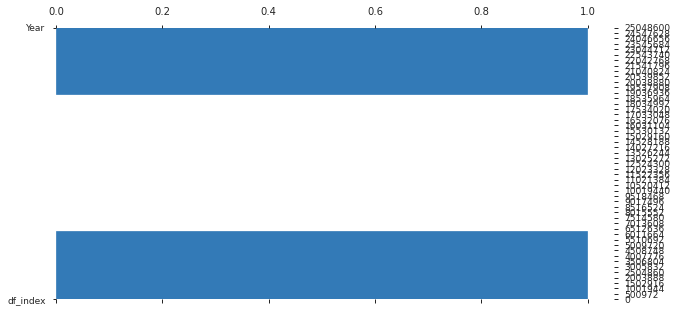

In [4]:
profile

## MODELING

A modellezéskor az indulási késést predikátluk meg. Ehhez a rendelkezésünkre álló feature-ket leszűkítettük a legrelevánsabbakra.
Ezek a következőek:
- DayofMonth: A hónap napja
- DayOfWeek : A hét napja
- CRSDepTime: Menetrendi indulás 
- CRSArrTime: Menetrendi érkezés
- CRSElapsedTime: Menetrend szerinti utazási hossz
- Distance: Repülési távolság
- airport_origin_lat : Kiindulási reptér szélességi fok
- airport_origin_long : Kiindulási reptér hosszúsági fok
- airport_dest_lat : Cél reptér szélességi fok
- airport_dest_long: Cél reptér hossz. fok

In [5]:
df = df.dropna(subset=['DepDelay'])

In [6]:
selected_cols = ['DayofMonth', 'DayOfWeek', 'CRSDepTime', 'CRSArrTime','CRSElapsedTime', 'Distance', 'airport_origin_lat', 'airport_origin_long', 'airport_dest_lat', 'airport_dest_long']
target = ['DepDelay']

### Train Test split

Tanító adathalmaz aránya : 75 %
Teszt adathalmaz aránya : 25 %

In [7]:
X_train, X_test, y_train, y_test = train_test_split(df[selected_cols], df[target], test_size=0.25, random_state=42, shuffle=True)

In [8]:
X_train.head()

,DayofMonth,DayOfWeek,CRSDepTime,CRSArrTime,CRSElapsedTime,Distance,airport_origin_lat,airport_origin_long,airport_dest_lat,airport_dest_long
1853255,5,5,635,1027,172.0,1174,30.194533,-97.669872,41.410894,-81.849397
824246,15,1,1615,1820,65.0,365,33.562943,-86.753550,30.494056,-81.687861
1328294,23,2,2006,2204,178.0,1037,41.302519,-95.894173,33.434167,-112.008056
3050609,1,1,906,915,69.0,214,33.640444,-84.426944,36.124477,-86.678182
3048249,9,2,1856,2019,83.0,356,33.640444,-84.426944,35.877639,-78.787472


## Regression

Három regressziós modellt teszteltünk le:
- Lineáris Regresszoó
- Lasso Regresszió
- ElasticNet regresszió

Az egyes modellek legjobb paramétrereinek kiválasztásához RandomSearch-t használtunk.
Kiszámoltuk még az egyes feature-k fontosságát is, minden lefuttatott modellhez.
A Legjobb modellnek az ElasticNet-es és a Lineáris Regresszió volt, szinte teljesen egyenlő hibaarányt értek el a tesztek alatt.

### 1. Linear Regression

In [9]:
lr = LinearRegression().fit(X_train, y_train)
y_pred = lr.predict(X_test)
print("MAE: " + str(mean_absolute_error(y_test, y_pred)))
print("MSE: " + str(mean_squared_error(y_test, y_pred)))

MAE: 18.77926040142679
MSE: 1140.1042935965609


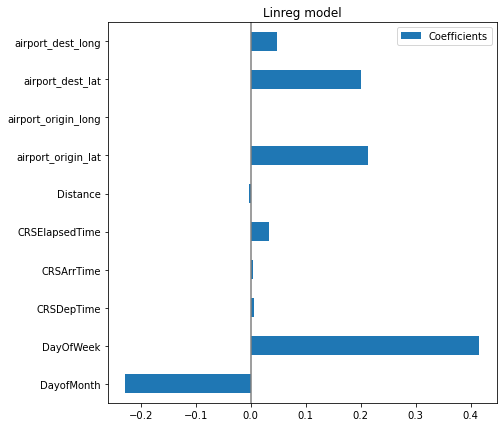

In [10]:
coefs = pd.DataFrame(
   lr.coef_[0],
   columns=['Coefficients'], index=X_train.columns
)
coefs.plot(kind='barh', figsize=(9, 7))
plt.title('Linreg model')
plt.axvline(x=0, color='.5')
plt.subplots_adjust(left=.3)

### 2. Lasso

In [11]:
lasso = linear_model.Lasso()

In [12]:
lasso_dict = dict()
lasso_dict['alpha'] = [0, 1, 2, 10]
lasso_dict['fit_intercept'] = [True, False]
lasso_dict['selection'] = ['cyclic', 'random']

In [13]:
clf = RandomizedSearchCV(lasso, lasso_dict, random_state=0)
search = clf.fit(X_train, y_train)
search.best_params_

{'selection': 'random', 'fit_intercept': True, 'alpha': 0}

In [14]:
lasso = linear_model.Lasso(selection='random', fit_intercept=True, random_state=0).fit(X_train, y_train)
y_pred2 = lasso.predict(X_test)
print("MAE: " + str(mean_absolute_error(y_test, y_pred2)))
print("MSE: " + str(mean_squared_error(y_test, y_pred2)))

MAE: 18.78344524766076
MSE: 1140.403304299497


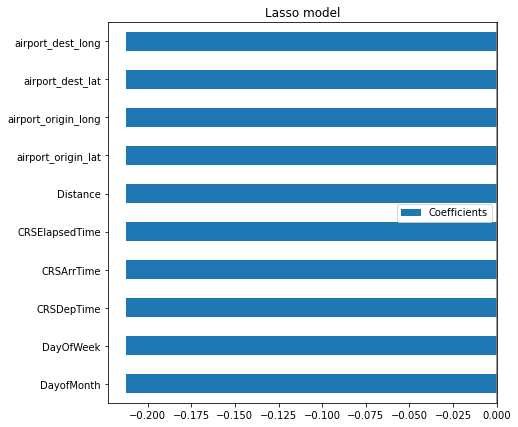

In [15]:
coefs = pd.DataFrame(
   lasso.coef_[0],
   columns=['Coefficients'], index=X_train.columns
)
coefs.plot(kind='barh', figsize=(9, 7))
plt.title('Lasso model')
plt.axvline(x=0, color='.5')
plt.subplots_adjust(left=.3)

### 3. ElasticNet

In [16]:
elnet = ElasticNet()

In [17]:
elnet_dict = dict()
elnet_dict['alpha'] = [0, 1, 2, 10]
elnet_dict['l1_ratio'] = [0.1, 0.5, 0.9]
elnet_dict['max_iter'] = [1000, 2000, 3000]

In [18]:
clf = RandomizedSearchCV(elnet, elnet_dict, random_state=0)
search = clf.fit(X_train, y_train)
search.best_params_

{'max_iter': 3000, 'l1_ratio': 0.1, 'alpha': 0}

In [19]:
elnet = ElasticNet(max_iter = 3000, l1_ratio =  0.1, random_state=0).fit(X_train, y_train)
y_pred1 = elnet.predict(X_test)
print("MAE: " + str(mean_absolute_error(y_test, y_pred1)))
print("MSE: " + str(mean_squared_error(y_test, y_pred1)))

MAE: 18.779793554231965
MSE: 1140.141953167044


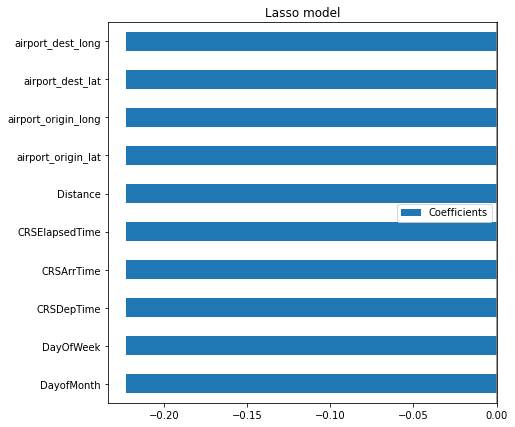

In [20]:
coefs = pd.DataFrame(
   elnet.coef_[0],
   columns=['Coefficients'], index=X_train.columns
)
coefs.plot(kind='barh', figsize=(9, 7))
plt.title('Lasso model')
plt.axvline(x=0, color='.5')
plt.subplots_adjust(left=.3)

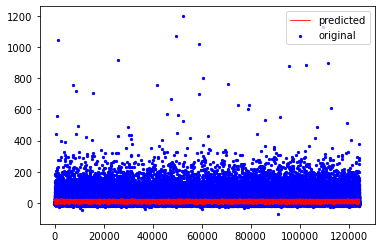

In [21]:
x_ax = range(len(X_test))
plt.scatter(x_ax, y_test, s=5, color="blue", label="original")
plt.plot(x_ax, y_pred, lw=0.8, color="red", label="predicted")
plt.legend()
plt.show()